<a href="https://colab.research.google.com/github/Noahms12/data-science-bootcamp/blob/main/Midterm_Porj.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
from google.colab import files

uploaded = files.upload()


Saving archive.zip to archive.zip


In [ ]:
import zipfile

with zipfile.ZipFile("archive.zip", 'r') as zip_ref:
    zip_ref.extractall()


In [ ]:
import os

for filename in os.listdir():
    print(filename)


.config
tmdb_5000_movies.csv
archive.zip
tmdb_5000_credits.csv
sample_data


In [ ]:
movies = pd.read_csv('tmdb_5000_movies.csv')
credits = pd.read_csv('tmdb_5000_credits.csv')

movies.head()


,budget,genres,homepage,id,keywords,original_language,original_title,overview,popularity,production_companies,production_countries,release_date,revenue,runtime,spoken_languages,status,tagline,title,vote_average,vote_count
0,237000000,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",http://www.avatarmovie.com/,19995,"[{""id"": 1463, ""name"": ""culture clash""}, {""id"":...",en,Avatar,"In the 22nd century, a paraplegic Marine is di...",150.437577,"[{""name"": ""Ingenious Film Partners"", ""id"": 289...","[{""iso_3166_1"": ""US"", ""name"": ""United States o...",2009-12-10,2787965087,162.0,"[{""iso_639_1"": ""en"", ""name"": ""English""}, {""iso...",Released,Enter the World of Pandora.,Avatar,7.2,11800
1,300000000,"[{""id"": 12, ""name"": ""Adventure""}, {""id"": 14, ""...",http://disney.go.com/disneypictures/pirates/,285,"[{""id"": 270, ""name"": ""ocean""}, {""id"": 726, ""na...",en,Pirates of the Caribbean: At World's End,"Captain Barbossa, long believed to be dead, ha...",139.082615,"[{""name"": ""Walt Disney Pictures"", ""id"": 2}, {""...","[{""iso_3166_1"": ""US"", ""name"": ""United States o...",2007-05-19,961000000,169.0,"[{""iso_639_1"": ""en"", ""name"": ""English""}]",Released,"At the end of the world, the adventure begins.",Pirates of the Caribbean: At World's End,6.9,4500
2,245000000,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",http://www.sonypictures.com/movies/spectre/,206647,"[{""id"": 470, ""name"": ""spy""}, {""id"": 818, ""name...",en,Spectre,A cryptic message from Bond’s past sends him o...,107.376788,"[{""name"": ""Columbia Pictures"", ""id"": 5}, {""nam...","[{""iso_3166_1"": ""GB"", ""name"": ""United Kingdom""...",2015-10-26,880674609,148.0,"[{""iso_639_1"": ""fr"", ""name"": ""Fran\u00e7ais""},...",Released,A Plan No One Escapes,Spectre,6.3,4466
3,250000000,"[{""id"": 28, ""name"": ""Action""}, {""id"": 80, ""nam...",http://www.thedarkknightrises.com/,49026,"[{""id"": 849, ""name"": ""dc comics""}, {""id"": 853,...",en,The Dark Knight Rises,Following the death of District Attorney Harve...,112.312950,"[{""name"": ""Legendary Pictures"", ""id"": 923}, {""...","[{""iso_3166_1"": ""US"", ""name"": ""United States o...",2012-07-16,1084939099,165.0,"[{""iso_639_1"": ""en"", ""name"": ""English""}]",Released,The Legend Ends,The Dark Knight Rises,7.6,9106
4,260000000,"[{""id"": 28, ""name"": ""Action""}, {""id"": 12, ""nam...",http://movies.disney.com/john-carter,49529,"[{""id"": 818, ""name"": ""based on novel""}, {""id"":...",en,John Carter,"John Carter is a war-weary, former military ca...",43.926995,"[{""name"": ""Walt Disney Pictures"", ""id"": 2}]","[{""iso_3166_1"": ""US"", ""name"": ""United States o...",2012-03-07,284139100,132.0,"[{""iso_639_1"": ""en"", ""name"": ""English""}]",Released,"Lost in our world, found in another.",John Carter,6.1,2124


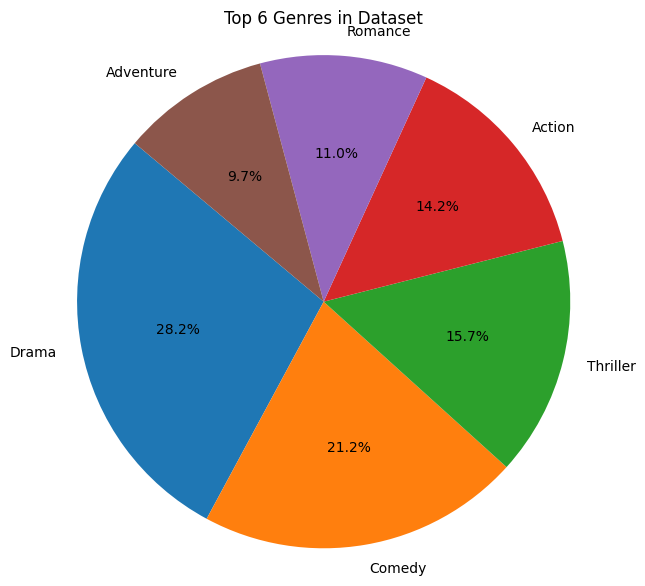

In [ ]:
# STEP 1: Load and Merge TMDB Data (if not already done)
import pandas as pd
import zipfile
import os

# Unzip your file (change filename if needed)
with zipfile.ZipFile('/content/archive.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/tmdb_data')

# Load CSVs
movies_df = pd.read_csv('/content/tmdb_data/tmdb_5000_movies.csv')
credits_df = pd.read_csv('/content/tmdb_data/tmdb_5000_credits.csv')

# Merge on title
merged_df = movies_df.merge(credits_df, on='title')
merged_df = merged_df[['movie_id', 'title', 'overview', 'genres', 'keywords', 'cast', 'crew', 'vote_average', 'popularity']]
merged_df.dropna(inplace=True)

# STEP 2: Create Genre Pie Chart
import ast
import matplotlib.pyplot as plt
from collections import Counter

def extract_genres(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        return [genre['name'] for genre in genres]
    except:
        return []

merged_df['genres_list'] = merged_df['genres'].apply(extract_genres)

# Count top 6 genres
all_genres = [genre for sublist in merged_df['genres_list'] for genre in sublist]
genre_counts = Counter(all_genres).most_common(6)
labels, sizes = zip(*genre_counts)

# Plot pie chart
plt.figure(figsize=(7, 7))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140)
plt.title("Top 6 Genres in Dataset")
plt.axis('equal')
plt.show()


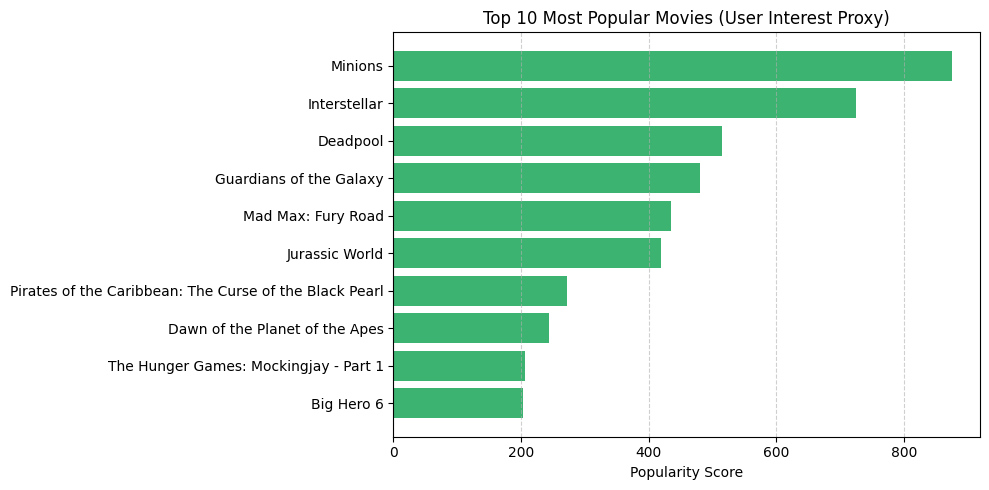

In [ ]:
import matplotlib.pyplot as plt

# Chart 1: Top 10 Most Popular Movies (User Interest Proxy)
top_popular = merged_df[['title', 'popularity']].sort_values(by='popularity', ascending=False).head(10)

plt.figure(figsize=(10, 5))
plt.barh(top_popular['title'][::-1], top_popular['popularity'][::-1], color='mediumseagreen')
plt.title("Top 10 Most Popular Movies (User Interest Proxy)")
plt.xlabel("Popularity Score")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


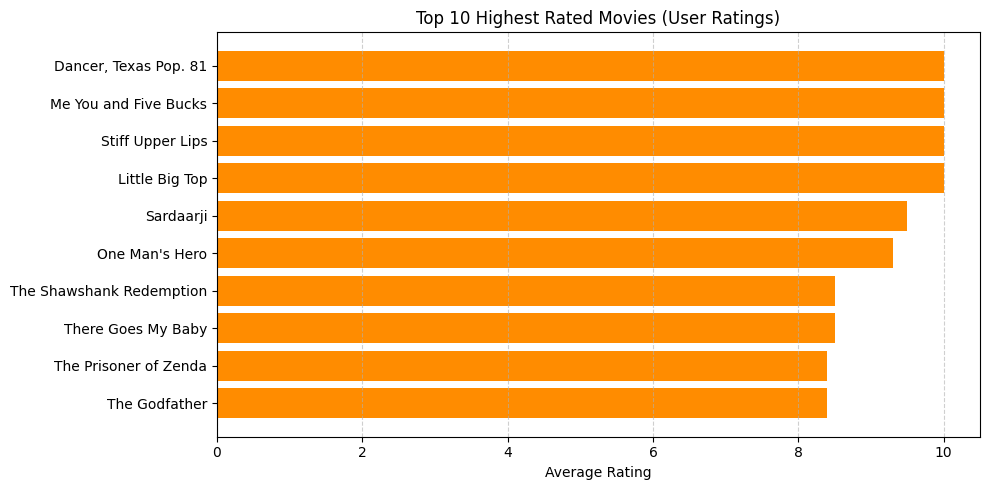

In [ ]:
# Chart 2: Top 10 Highest Rated Movies (User Ratings)
top_rated = merged_df[['title', 'vote_average']].sort_values(by='vote_average', ascending=False).head(10)

plt.figure(figsize=(10, 5))
plt.barh(top_rated['title'][::-1], top_rated['vote_average'][::-1], color='darkorange')
plt.title("Top 10 Highest Rated Movies (User Ratings)")
plt.xlabel("Average Rating")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


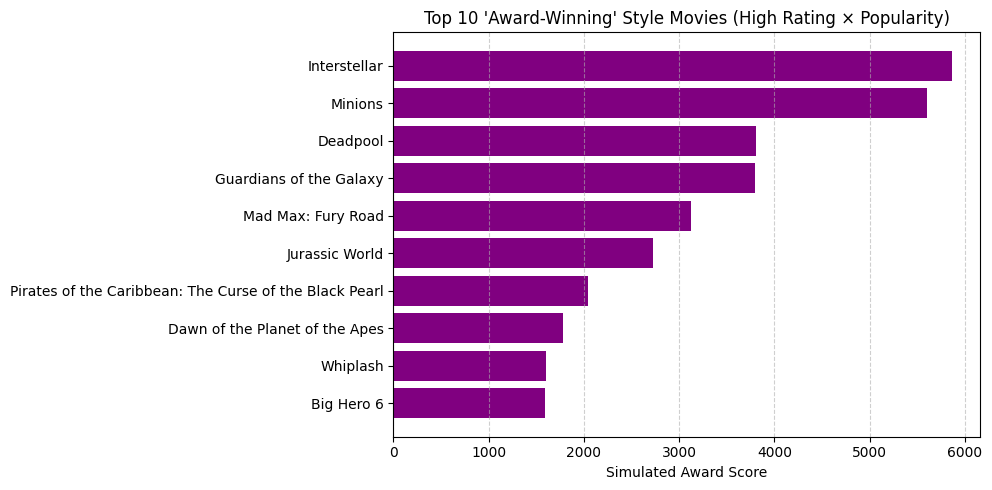

In [ ]:
# Chart 3: Simulated Award-Winning Movies (High Rating × Popularity)
merged_df['score'] = merged_df['vote_average'] * merged_df['popularity']
top_award_like = merged_df[['title', 'score']].sort_values(by='score', ascending=False).head(10)

plt.figure(figsize=(10, 5))
plt.barh(top_award_like['title'][::-1], top_award_like['score'][::-1], color='purple')
plt.title("Top 10 'Award-Winning' Style Movies (High Rating × Popularity)")
plt.xlabel("Simulated Award Score")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


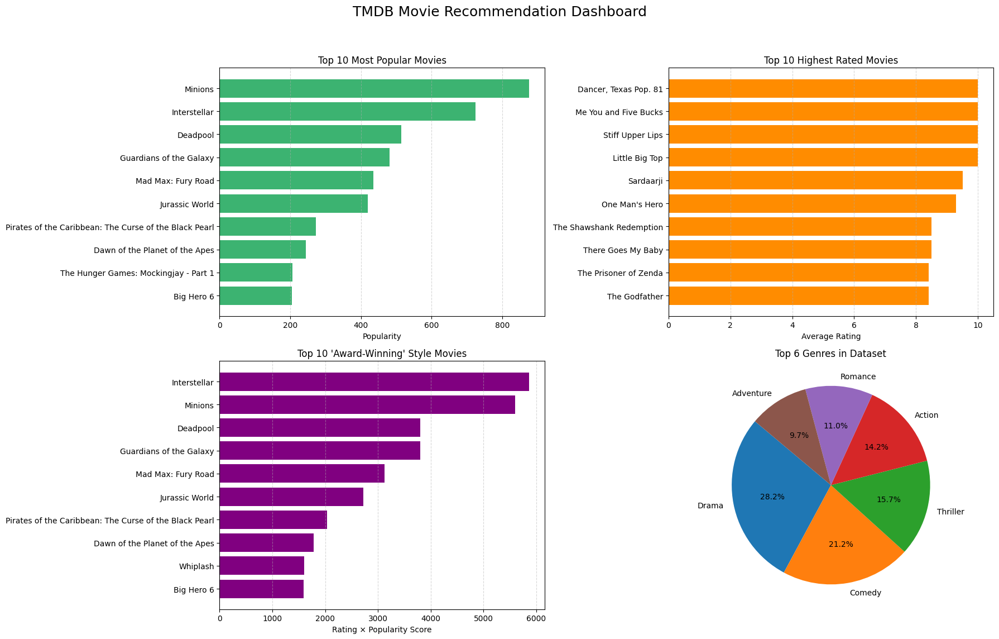

In [ ]:
import matplotlib.pyplot as plt
import ast
from collections import Counter

# --- REUSE CALCULATIONS --- #

# Top 10 Most Popular
top_popular = merged_df[['title', 'popularity']].sort_values(by='popularity', ascending=False).head(10)

# Top 10 Highest Rated
top_rated = merged_df[['title', 'vote_average']].sort_values(by='vote_average', ascending=False).head(10)

# Simulated Award-Winning
merged_df['score'] = merged_df['vote_average'] * merged_df['popularity']
top_award = merged_df[['title', 'score']].sort_values(by='score', ascending=False).head(10)

# Extract genres for pie chart
def extract_genres(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        return [genre['name'] for genre in genres]
    except:
        return []

merged_df['genres_list'] = merged_df['genres'].apply(extract_genres)
all_genres = [genre for sublist in merged_df['genres_list'] for genre in sublist]
genre_counts = Counter(all_genres).most_common(6)
genre_labels, genre_sizes = zip(*genre_counts)

# --- PLOTTING --- #

fig, axs = plt.subplots(2, 2, figsize=(18, 12))
fig.suptitle('TMDB Movie Recommendation Dashboard', fontsize=18)

# Chart 1: Popular Movies
axs[0, 0].barh(top_popular['title'][::-1], top_popular['popularity'][::-1], color='mediumseagreen')
axs[0, 0].set_title("Top 10 Most Popular Movies")
axs[0, 0].set_xlabel("Popularity")
axs[0, 0].grid(axis='x', linestyle='--', alpha=0.5)

# Chart 2: Highest Rated Movies
axs[0, 1].barh(top_rated['title'][::-1], top_rated['vote_average'][::-1], color='darkorange')
axs[0, 1].set_title("Top 10 Highest Rated Movies")
axs[0, 1].set_xlabel("Average Rating")
axs[0, 1].grid(axis='x', linestyle='--', alpha=0.5)

# Chart 3: Award-Winning Style
axs[1, 0].barh(top_award['title'][::-1], top_award['score'][::-1], color='purple')
axs[1, 0].set_title("Top 10 'Award-Winning' Style Movies")
axs[1, 0].set_xlabel("Rating × Popularity Score")
axs[1, 0].grid(axis='x', linestyle='--', alpha=0.5)

# Chart 4: Genre Pie Chart
axs[1, 1].pie(genre_sizes, labels=genre_labels, autopct='%1.1f%%', startangle=140)
axs[1, 1].set_title("Top 6 Genres in Dataset")

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


<ipython-input-14-72b9c7aaaf64>:43: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


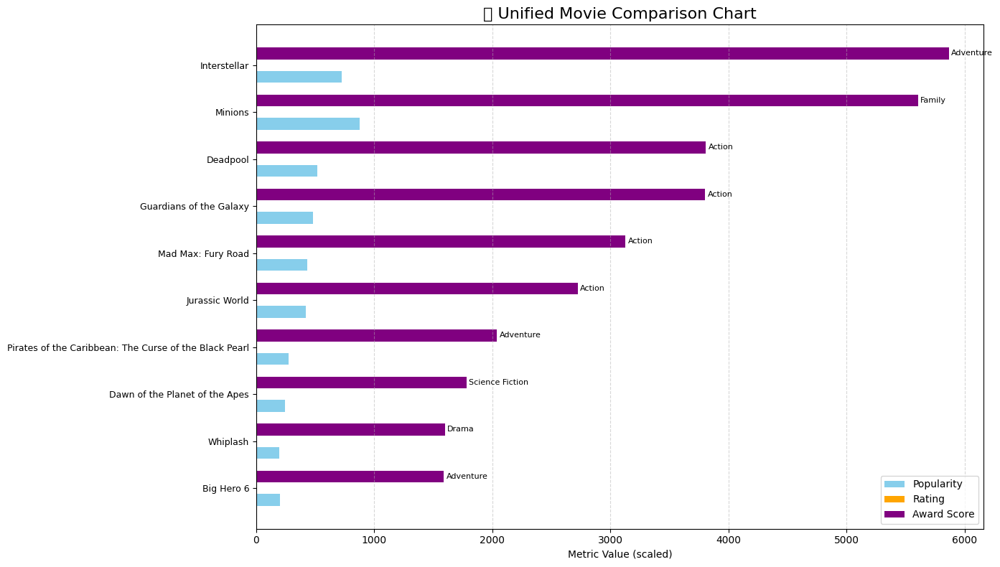

In [ ]:
import matplotlib.pyplot as plt
import ast
import pandas as pd

# --- Extract Genre (first one only, as text label) ---
def extract_genres(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        return genres[0]['name'] if genres else 'Unknown'
    except:
        return 'Unknown'

# Calculate award-style score
merged_df['score'] = merged_df['vote_average'] * merged_df['popularity']
merged_df['main_genre'] = merged_df['genres'].apply(extract_genres)

# Select top 10 movies based on score
top10 = merged_df.sort_values(by='score', ascending=False).head(10)

# Plot
fig, ax = plt.subplots(figsize=(14, 8))

bar_width = 0.25
index = range(len(top10))

# Plot bars for each metric
ax.barh([i + bar_width for i in index], top10['popularity'], height=bar_width, label='Popularity', color='skyblue')
ax.barh(index, top10['vote_average'], height=bar_width, label='Rating', color='orange')
ax.barh([i - bar_width for i in index], top10['score'], height=bar_width, label='Award Score', color='purple')

# Y-axis labels
ax.set_yticks(index)
ax.set_yticklabels(top10['title'], fontsize=9)
ax.invert_yaxis()

# Add genre as text next to bars
for i, genre in enumerate(top10['main_genre']):
    ax.text(top10['score'].iloc[i] + 20, i - bar_width, genre, va='center', fontsize=8, color='black')

ax.set_title("🎬 Unified Movie Comparison Chart", fontsize=16)
ax.set_xlabel("Metric Value (scaled)")
ax.legend()
plt.tight_layout()
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.show()


In [ ]:
#to create user rating column
movies_df = pd.read_csv('/content/tmdb_data/tmdb_5000_movies.csv')
credits_df = pd.read_csv('/content/tmdb_data/tmdb_5000_credits.csv')

# ✅ Make sure vote_count is included
merged_df = movies_df.merge(credits_df, on='title')
merged_df = merged_df[['movie_id', 'title', 'overview', 'genres', 'keywords', 'cast', 'crew',
                       'vote_average', 'vote_count', 'popularity']]
merged_df.dropna(inplace=True)



<ipython-input-17-5d63f06e2f68>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_df.dropna(inplace=True)


<ipython-input-18-5701fa20736b>:52: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


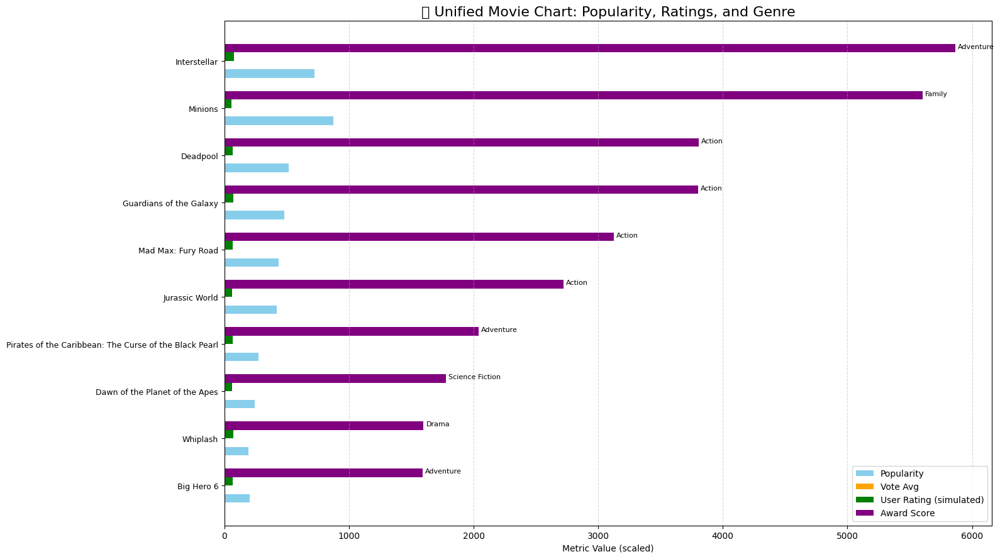

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import ast

# ✅ If you haven't merged already:
# merged_df = movies_df.merge(credits_df, on='title')
# merged_df = merged_df[['movie_id', 'title', 'overview', 'genres', 'keywords', 'cast', 'crew', 'vote_average', 'vote_count', 'popularity']]
# merged_df.dropna(inplace=True)

# Extract genre text (first one)
def extract_genres(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        return genres[0]['name'] if genres else 'Unknown'
    except:
        return 'Unknown'

# Add computed columns
merged_df['main_genre'] = merged_df['genres'].apply(extract_genres)
merged_df['score'] = merged_df['vote_average'] * merged_df['popularity']
merged_df['user_rating'] = merged_df.apply(lambda row: row['vote_average'] * math.log(row['vote_count'] + 1), axis=1)

# Top 10 movies by award-style score
top10 = merged_df.sort_values(by='score', ascending=False).head(10)

# Plotting unified chart
fig, ax = plt.subplots(figsize=(16, 9))
bar_width = 0.18
index = np.arange(len(top10))

# Bars
ax.barh(index + bar_width*1.5, top10['popularity'], height=bar_width, label='Popularity', color='skyblue')
ax.barh(index + bar_width*0.5, top10['vote_average'], height=bar_width, label='Vote Avg', color='orange')
ax.barh(index - bar_width*0.5, top10['user_rating'], height=bar_width, label='User Rating (simulated)', color='green')
ax.barh(index - bar_width*1.5, top10['score'], height=bar_width, label='Award Score', color='purple')

# Labels
ax.set_yticks(index)
ax.set_yticklabels(top10['title'], fontsize=9)
ax.invert_yaxis()

# Add genres as labels
for i, genre in enumerate(top10['main_genre']):
    ax.text(top10['score'].iloc[i] + 20, i - bar_width*1.5, genre, fontsize=8, color='black')

ax.set_title("🎬 Unified Movie Chart: Popularity, Ratings, and Genre", fontsize=16)
ax.set_xlabel("Metric Value (scaled)")
ax.legend(loc='lower right')
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


In [ ]:
#to get user rating out of 10
merged_df[['title', 'vote_average', 'vote_count']].head(10)


,title,vote_average,vote_count
0,Avatar,7.2,11800
1,Pirates of the Caribbean: At World's End,6.9,4500
2,Spectre,6.3,4466
3,The Dark Knight Rises,7.6,9106
4,John Carter,6.1,2124
5,Spider-Man 3,5.9,3576
6,Tangled,7.4,3330
7,Avengers: Age of Ultron,7.3,6767
8,Harry Potter and the Half-Blood Prince,7.4,5293
9,Batman v Superman: Dawn of Justice,5.7,7004


<ipython-input-20-bc9c7033f3a1>:65: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


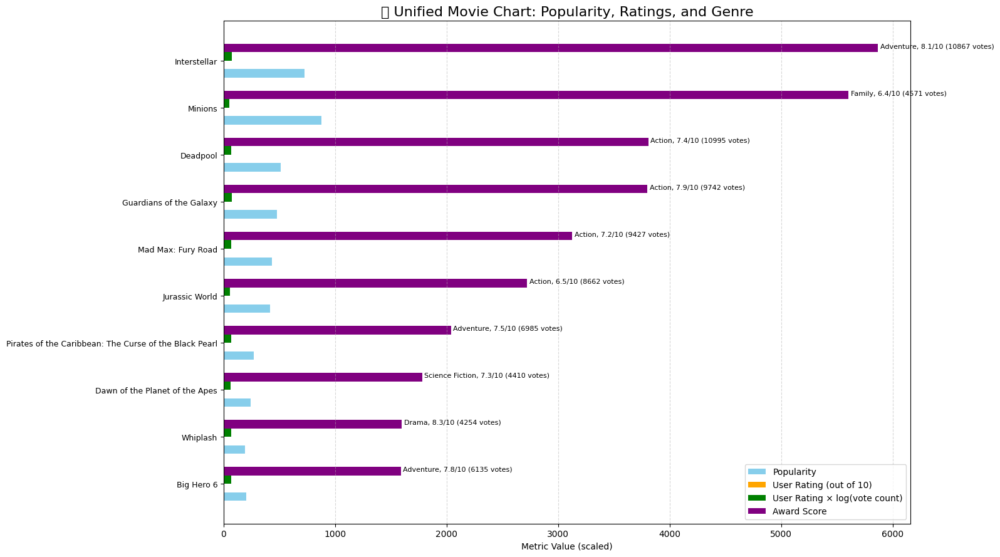

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import ast

# If you haven't already loaded and merged the dataset
movies_df = pd.read_csv('/content/tmdb_data/tmdb_5000_movies.csv')
credits_df = pd.read_csv('/content/tmdb_data/tmdb_5000_credits.csv')

# Merge datasets on title
merged_df = movies_df.merge(credits_df, on='title')
merged_df = merged_df[['movie_id', 'title', 'overview', 'genres', 'keywords', 'cast', 'crew',
                       'vote_average', 'vote_count', 'popularity']]
merged_df.columns = merged_df.columns.str.strip()
merged_df.dropna(inplace=True)

# Extract first genre
def extract_genres(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        return genres[0]['name'] if genres else 'Unknown'
    except:
        return 'Unknown'

# Add calculated columns
merged_df['main_genre'] = merged_df['genres'].apply(extract_genres)
merged_df['score'] = merged_df['vote_average'] * merged_df['popularity']
merged_df['user_rating_score'] = merged_df.apply(
    lambda row: row['vote_average'] * math.log(row['vote_count'] + 1), axis=1
)

# Select top 10 movies based on award score
top10 = merged_df.sort_values(by='score', ascending=False).head(10)

# Plotting
fig, ax = plt.subplots(figsize=(16, 9))
bar_width = 0.18
index = np.arange(len(top10))

# Plot bars
ax.barh(index + bar_width*1.5, top10['popularity'], height=bar_width, label='Popularity', color='skyblue')
ax.barh(index + bar_width*0.5, top10['vote_average'], height=bar_width, label='User Rating (out of 10)', color='orange')
ax.barh(index - bar_width*0.5, top10['user_rating_score'], height=bar_width, label='User Rating × log(vote count)', color='green')
ax.barh(index - bar_width*1.5, top10['score'], height=bar_width, label='Award Score', color='purple')

# Add y-axis labels
ax.set_yticks(index)
ax.set_yticklabels(top10['title'], fontsize=9)
ax.invert_yaxis()

# Annotate with genre and actual ratings
for i in range(len(top10)):
    genre = top10['main_genre'].iloc[i]
    rating = top10['vote_average'].iloc[i]
    count = int(top10['vote_count'].iloc[i])
    ax.text(top10['score'].iloc[i] + 20, i - bar_width*1.5,
            f"{genre}, {rating}/10 ({count} votes)", fontsize=8, color='black')

# Final touches
ax.set_title("🎬 Unified Movie Chart: Popularity, Ratings, and Genre", fontsize=16)
ax.set_xlabel("Metric Value (scaled)")
ax.legend(loc='lower right')
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


In [ ]:
selected_titles = [
    'Tangled',
    'Frozen',
    'Moana',
    'Zootopia',
    'Inside Out',
    'Up',
    'Ratatouille',
    'Big Hero 6',
    'Coco',
    'Brave'
]


<ipython-input-22-a35d323f6a0b>:59: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


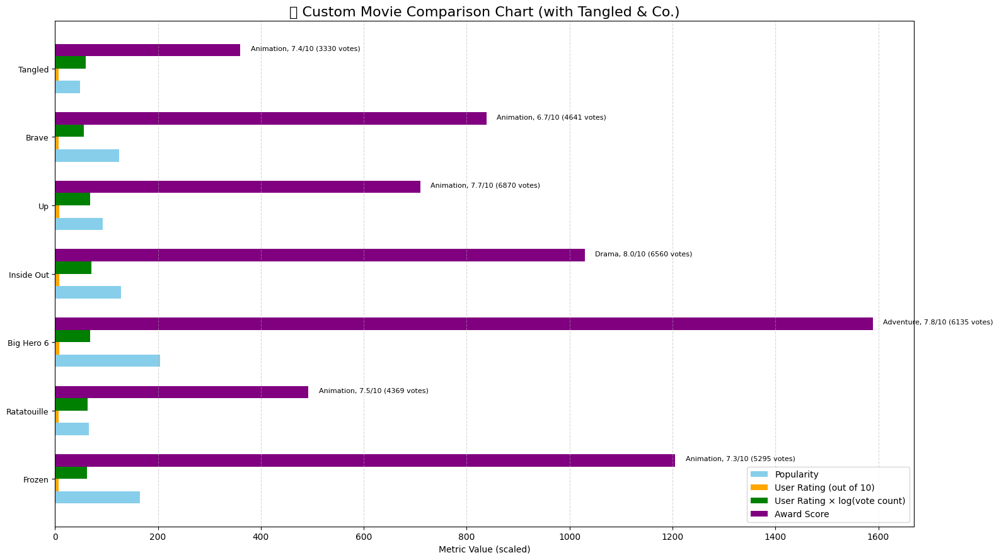

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import ast

# Define selected movies (add/remove as needed)
selected_titles = [
    'Tangled', 'Frozen', 'Moana', 'Zootopia', 'Inside Out',
    'Up', 'Ratatouille', 'Big Hero 6', 'Coco', 'Brave'
]

# Filter dataset
custom_df = merged_df[merged_df['title'].isin(selected_titles)].copy()

# Clean and compute
def extract_genres(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        return genres[0]['name'] if genres else 'Unknown'
    except:
        return 'Unknown'

custom_df['main_genre'] = custom_df['genres'].apply(extract_genres)
custom_df['score'] = custom_df['vote_average'] * custom_df['popularity']
custom_df['user_rating_score'] = custom_df.apply(
    lambda row: row['vote_average'] * math.log(row['vote_count'] + 1), axis=1
)

# Plotting
fig, ax = plt.subplots(figsize=(16, 9))
bar_width = 0.18
index = np.arange(len(custom_df))

# Bars
ax.barh(index + bar_width*1.5, custom_df['popularity'], height=bar_width, label='Popularity', color='skyblue')
ax.barh(index + bar_width*0.5, custom_df['vote_average'], height=bar_width, label='User Rating (out of 10)', color='orange')
ax.barh(index - bar_width*0.5, custom_df['user_rating_score'], height=bar_width, label='User Rating × log(vote count)', color='green')
ax.barh(index - bar_width*1.5, custom_df['score'], height=bar_width, label='Award Score', color='purple')

# Labels
ax.set_yticks(index)
ax.set_yticklabels(custom_df['title'], fontsize=9)
ax.invert_yaxis()

# Annotate with genre and user rating
for i in range(len(custom_df)):
    genre = custom_df['main_genre'].iloc[i]
    rating = custom_df['vote_average'].iloc[i]
    count = int(custom_df['vote_count'].iloc[i])
    ax.text(custom_df['score'].iloc[i] + 20, i - bar_width*1.5,
            f"{genre}, {rating}/10 ({count} votes)", fontsize=8, color='black')

# Final touches
ax.set_title("🎬 Custom Movie Comparison Chart (with Tangled & Co.)", fontsize=16)
ax.set_xlabel("Metric Value (scaled)")
ax.legend(loc='lower right')
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


In [ ]:
#ALL MOVIES COMPARISON CHART
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import ast

# OPTIONAL: Reload if not already done
movies_df = pd.read_csv('/content/tmdb_data/tmdb_5000_movies.csv')
credits_df = pd.read_csv('/content/tmdb_data/tmdb_5000_credits.csv')
merged_df = movies_df.merge(credits_df, on='title')
merged_df = merged_df[['movie_id', 'title', 'overview', 'genres', 'keywords', 'cast', 'crew',
                       'vote_average', 'vote_count', 'popularity']]
merged_df.columns = merged_df.columns.str.strip()
merged_df.dropna(inplace=True)

# Extract genre
def extract_genres(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        return genres[0]['name'] if genres else 'Unknown'
    except:
        return 'Unknown'

merged_df['main_genre'] = merged_df['genres'].apply(extract_genres)

# Compute metrics
merged_df['score'] = merged_df['vote_average'] * merged_df['popularity']
merged_df['user_rating_score'] = merged_df.apply(
    lambda row: row['vote_average'] * math.log(row['vote_count'] + 1), axis=1
)

# Final dataset
all_movies_df = merged_df.copy()
n = len(all_movies_df)

# Plotting ALL MOVIES
fig, ax = plt.subplots(figsize=(16, n * 0.3))  # dynamically scale height
bar_width = 0.18
index = np.arange(n)

# Plot all bars
ax.barh(index + bar_width*1.5, all_movies_df['popularity'], height=bar_width, label='Popularity', color='skyblue')
ax.barh(index + bar_width*0.5, all_movies_df['vote_average'], height=bar_width, label='User Rating (out of 10)', color='orange')
ax.barh(index - bar_width*0.5, all_movies_df['user_rating_score'], height=bar_width, label='User Rating × log(vote count)', color='green')
ax.barh(index - bar_width*1.5, all_movies_df['score'], height=bar_width, label='Award Score', color='purple')

# Y-axis labels
ax.set_yticks(index)
ax.set_yticklabels(all_movies_df['title'], fontsize=7)
ax.invert_yaxis()

# Add genre + rating + votes as labels (optional)
for i in range(n):
    genre = all_movies_df['main_genre'].iloc[i]
    rating = all_movies_df['vote_average'].iloc[i]
    count = int(all_movies_df['vote_count'].iloc[i])
    ax.text(all_movies_df['score'].iloc[i] + 5, i - bar_width*1.5,
            f"{genre}, {rating}/10 ({count} votes)", fontsize=6, color='black')

# Final polish
ax.set_title("🎬 ALL Movies Comparison Chart", fontsize=16)
ax.set_xlabel("Metric Value (scaled)")
ax.legend(loc='lower right')
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


<ipython-input-23-0029907dda8d>:66: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


In [ ]:
plt.savefig("all_movies_chart.png", dpi=300, bbox_inches='tight')


<Figure size 640x480 with 0 Axes>

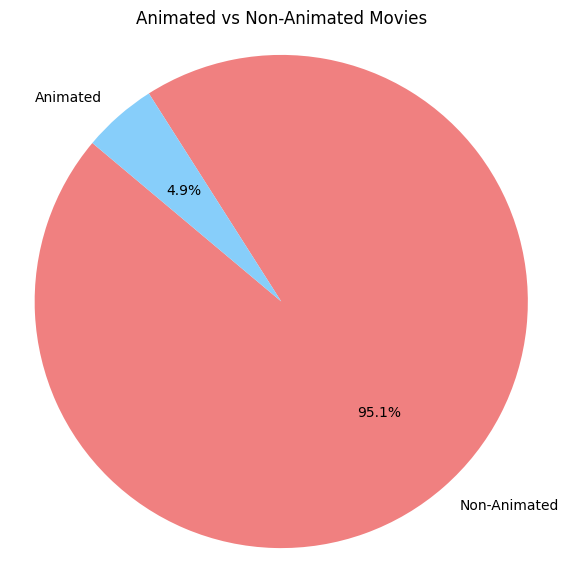

In [ ]:
#chart based on animated and non-animated
import matplotlib.pyplot as plt
import ast

# Function to check if a movie is animated
def is_animated(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        genre_names = [genre['name'] for genre in genres]
        return 'Animation' in genre_names
    except:
        return False

# Create a new column for classification
merged_df['is_animated'] = merged_df['genres'].apply(is_animated)

# Count animated vs non-animated movies
animation_counts = merged_df['is_animated'].value_counts()
labels = ['Non-Animated', 'Animated']
sizes = [animation_counts[False], animation_counts[True]]

# Plot pie chart
plt.figure(figsize=(7, 7))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140, colors=['lightcoral', 'lightskyblue'])
plt.title("Animated vs Non-Animated Movies")
plt.axis('equal')  # Equal aspect ratio ensures the pie is circular.
plt.show()


<ipython-input-26-4201032b6816>:115: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  plt.tight_layout(rect=[0, 0.03, 1, 0.95])
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127916 (\N{CLAPPER BOARD}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


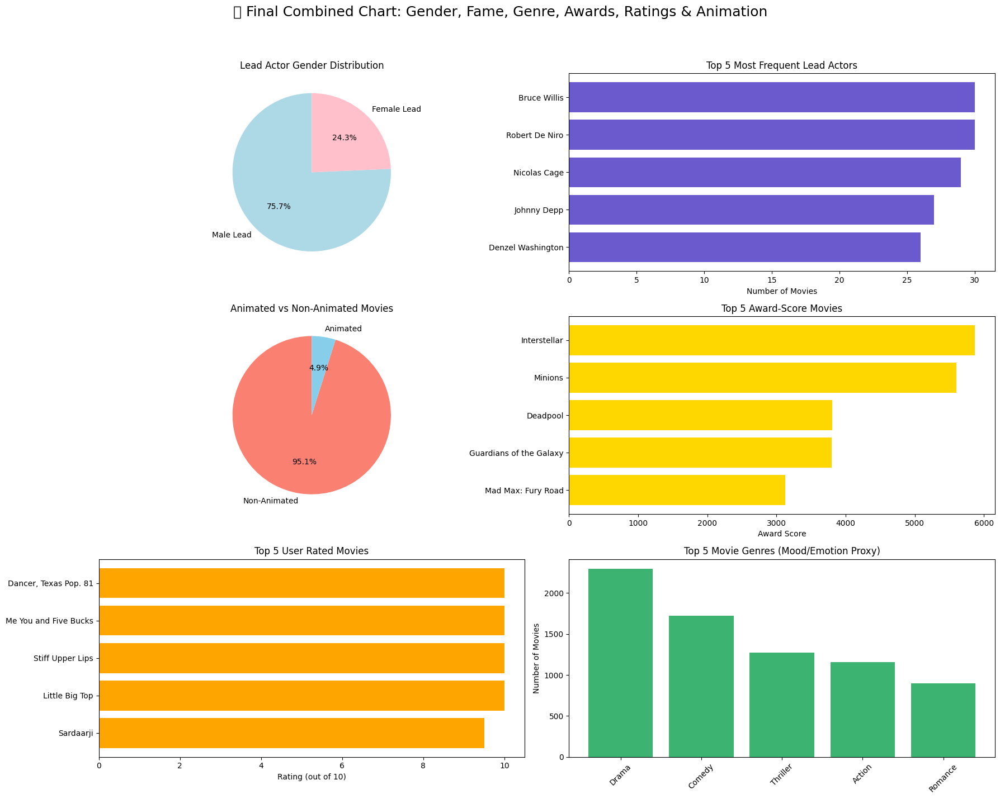

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import ast
import math
from collections import Counter

# Load datasets (adjust path if needed)
movies_df = pd.read_csv('/content/tmdb_data/tmdb_5000_movies.csv')
credits_df = pd.read_csv('/content/tmdb_data/tmdb_5000_credits.csv')

# Merge and clean
merged_df = movies_df.merge(credits_df, on='title')
merged_df = merged_df[['movie_id', 'title', 'overview', 'genres', 'keywords', 'cast', 'crew',
                       'vote_average', 'vote_count', 'popularity']]
merged_df.columns = merged_df.columns.str.strip()
merged_df.dropna(inplace=True)

# Helper functions
def extract_genres(genres_str):
    try:
        genres = ast.literal_eval(genres_str)
        return [genre['name'] for genre in genres]
    except:
        return []

def extract_top_actor(cast_str):
    try:
        cast = ast.literal_eval(cast_str)
        return cast[0]['name'] if cast else None
    except:
        return None

def is_female_lead(cast_str):
    try:
        cast = ast.literal_eval(cast_str)
        if cast and 'gender' in cast[0]:
            return cast[0]['gender'] == 1  # 1 = Female, 2 = Male
    except:
        pass
    return False

def is_animated(genres_list):
    return 'Animation' in genres_list

def extract_director(crew_str):
    try:
        crew = ast.literal_eval(crew_str)
        for member in crew:
            if member['job'] == 'Director':
                return member['name']
    except:
        return None

# Process data
merged_df['genres_list'] = merged_df['genres'].apply(extract_genres)
merged_df['lead_actor'] = merged_df['cast'].apply(extract_top_actor)
merged_df['is_female_lead'] = merged_df['cast'].apply(is_female_lead)
merged_df['is_animated'] = merged_df['genres_list'].apply(is_animated)
merged_df['director'] = merged_df['crew'].apply(extract_director)
merged_df['award_score'] = merged_df['vote_average'] * merged_df['popularity']
merged_df['user_rating_score'] = merged_df.apply(lambda row: row['vote_average'] * math.log(row['vote_count'] + 1), axis=1)

# Data for subplots
gender_counts = merged_df['is_female_lead'].value_counts()
gender_labels = ['Male Lead', 'Female Lead']
gender_sizes = [gender_counts[False], gender_counts[True]]

top_actors = merged_df['lead_actor'].value_counts().head(5)

animation_counts = merged_df['is_animated'].value_counts()
animation_labels = ['Non-Animated', 'Animated']
animation_sizes = [animation_counts[False], animation_counts[True]]

top_awards = merged_df.sort_values(by='award_score', ascending=False).head(5)[['title', 'award_score']]
top_ratings = merged_df.sort_values(by='vote_average', ascending=False).head(5)[['title', 'vote_average']]

all_genres = [genre for sublist in merged_df['genres_list'] for genre in sublist]
top_genres = Counter(all_genres).most_common(5)
genre_labels, genre_counts = zip(*top_genres)

# Plotting all charts
fig, axs = plt.subplots(3, 2, figsize=(18, 15))
fig.suptitle("🎬 Final Combined Chart: Gender, Fame, Genre, Awards, Ratings & Animation", fontsize=18)

# Chart 1: Gender of Lead Actor
axs[0, 0].pie(gender_sizes, labels=gender_labels, autopct='%1.1f%%', colors=['lightblue', 'pink'], startangle=90)
axs[0, 0].set_title("Lead Actor Gender Distribution")

# Chart 2: Famous Lead Actors
axs[0, 1].barh(top_actors.index[::-1], top_actors.values[::-1], color='slateblue')
axs[0, 1].set_title("Top 5 Most Frequent Lead Actors")
axs[0, 1].set_xlabel("Number of Movies")

# Chart 3: Animated vs Non-Animated
axs[1, 0].pie(animation_sizes, labels=animation_labels, autopct='%1.1f%%', colors=['salmon', 'skyblue'], startangle=90)
axs[1, 0].set_title("Animated vs Non-Animated Movies")

# Chart 4: Awards/Recognition
axs[1, 1].barh(top_awards['title'][::-1], top_awards['award_score'][::-1], color='gold')
axs[1, 1].set_title("Top 5 Award-Score Movies")
axs[1, 1].set_xlabel("Award Score")

# Chart 5: User Ratings
axs[2, 0].barh(top_ratings['title'][::-1], top_ratings['vote_average'][::-1], color='orange')
axs[2, 0].set_title("Top 5 User Rated Movies")
axs[2, 0].set_xlabel("Rating (out of 10)")

# Chart 6: Mood/Emotion by Genre
axs[2, 1].bar(genre_labels, genre_counts, color='mediumseagreen')
axs[2, 1].set_title("Top 5 Movie Genres (Mood/Emotion Proxy)")
axs[2, 1].set_ylabel("Number of Movies")
axs[2, 1].tick_params(axis='x', rotation=45)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()
